Fetching 6 files:   0%|          | 0/6 [00:00<?, ?it/s]

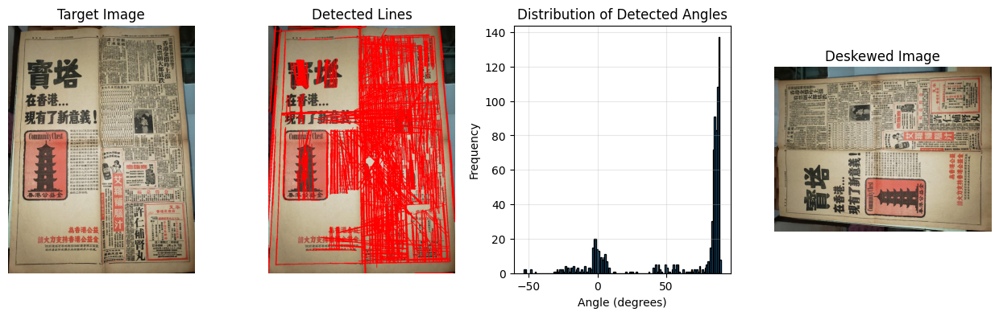

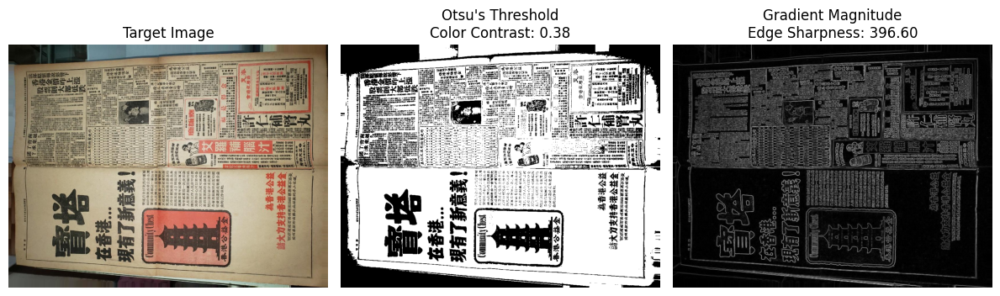

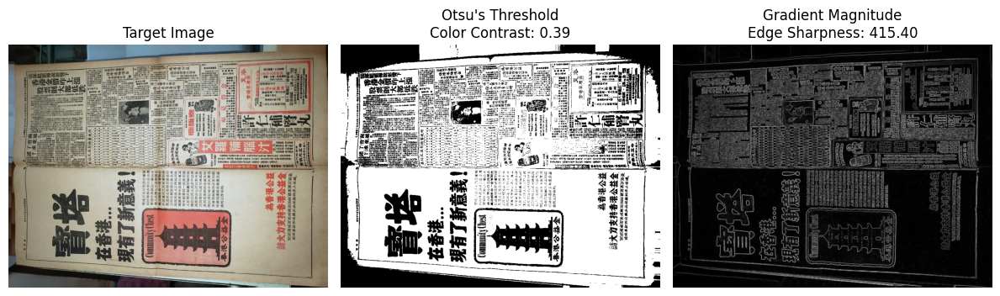

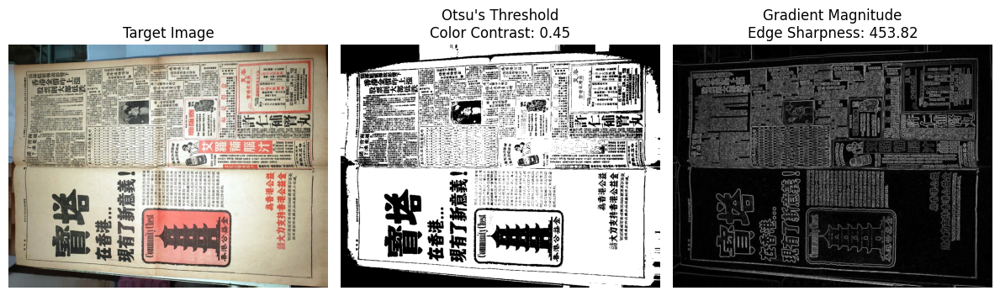

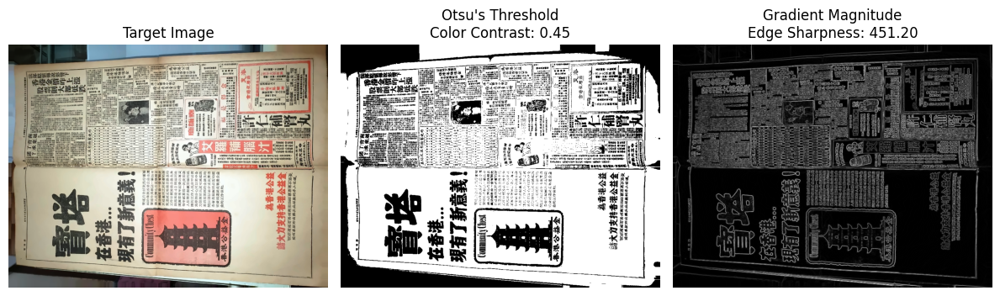

...

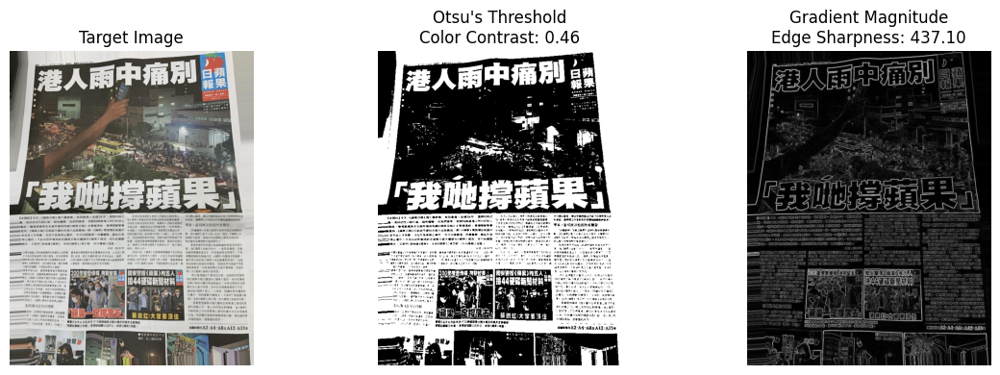

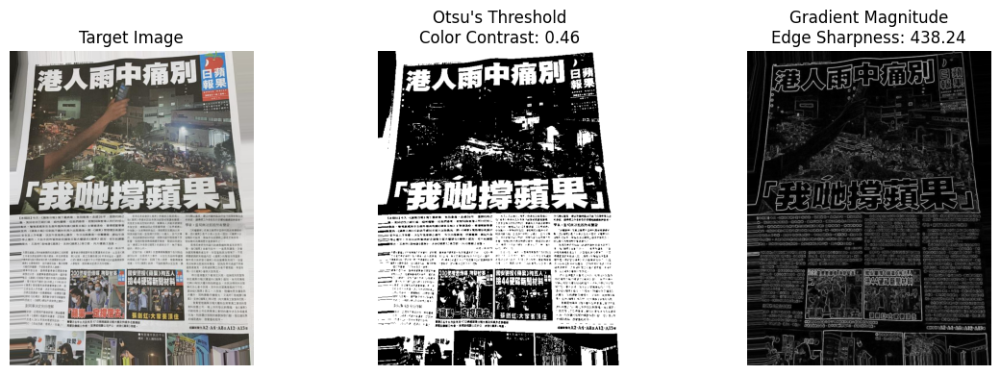

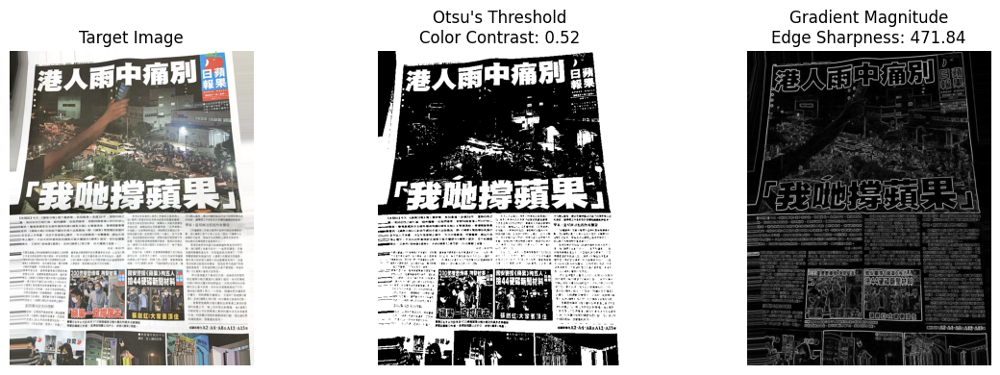

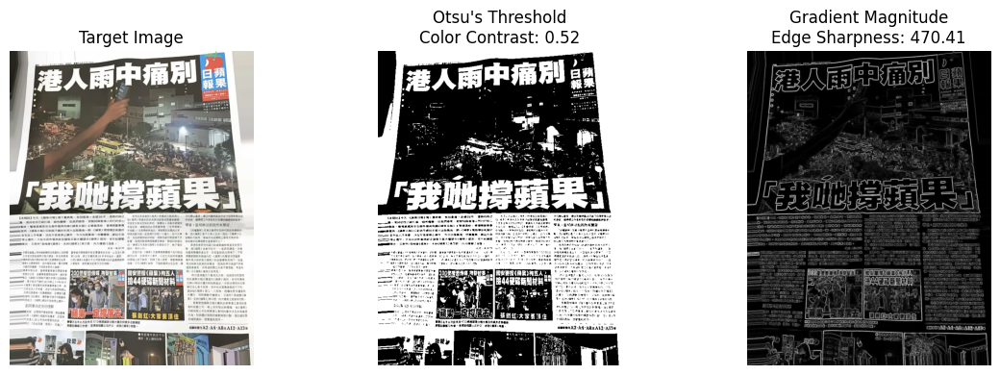

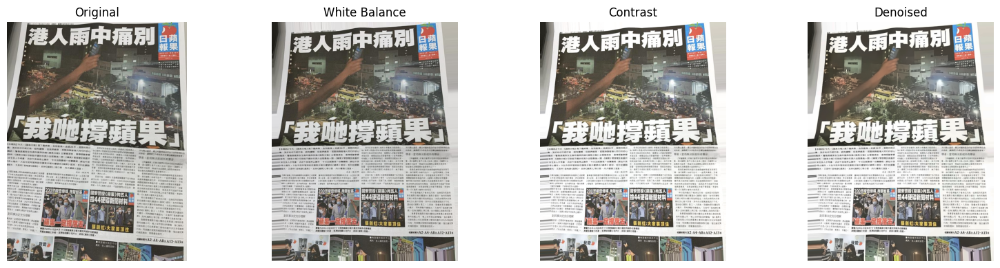

In [ ]:
from pathlib import Path

import matplotlib.pyplot as plt
from PIL import Image

from newspaper_ocr.preprocess import (
    adjust_contrast,
    adjust_whitebalance,
    check_text_clarity,
    denoise_image,
    deskew_image,
)

metrics_data = {}

for image_path in Path("../data/images").iterdir():
    # Load image
    image = Image.open(image_path)
    filename = image_path.stem + image_path.suffix

    # Process image through pipeline
    deskewed = deskew_image(image, plot=True)
    _, metrics_orig = check_text_clarity(deskewed, plot=True)

    wb_adjusted = adjust_whitebalance(deskewed, wb_percentile=99)
    _, metrics_wb = check_text_clarity(wb_adjusted, plot=True)

    contrast_adjusted = adjust_contrast(wb_adjusted, contrast=1.15)
    _, metrics_contrast = check_text_clarity(contrast_adjusted, plot=True)

    denoised = denoise_image(contrast_adjusted)
    _, metrics_denoise = check_text_clarity(denoised, plot=True)

    # Display processing stages
    fig, axes = plt.subplots(1, 4, figsize=(16, 4))
    images = [image, wb_adjusted, contrast_adjusted, denoised]
    titles = ["Original", "White Balance", "Contrast", "Denoised"]

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img)
        ax.set_title(title)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

    # Store metrics
    metrics_data[image_path.stem] = {
        "original": metrics_orig,
        "adjust_whitebalance": metrics_wb,
        "contrast_increase": metrics_contrast,
        "denoised": metrics_denoise,
    }

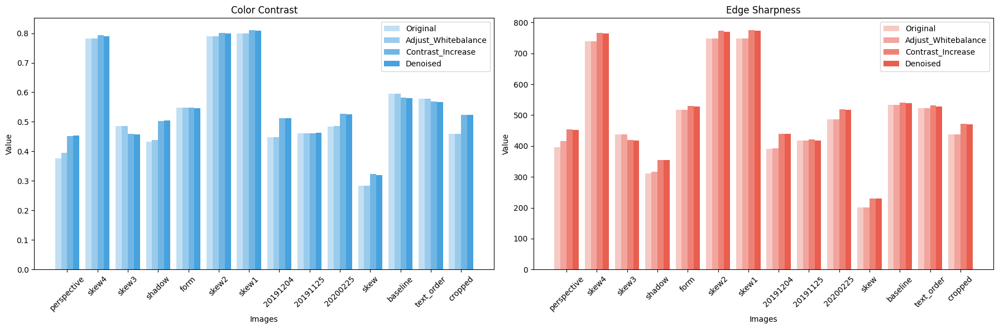

In [ ]:
import numpy as np

# Create separate plots for each metric
metrics = ["color_contrast", "edge_sharpness"]
titles = ["Color Contrast", "Edge Sharpness"]
colors = ["#3498db", "#e74c3c"]  # Blue for contrast, red for sharpness

# Get all processing types from the first image's data
processing_types = list(next(iter(metrics_data.values())).keys())
num_types = len(processing_types)
width = 0.8 / num_types  # Adjust bar width based on number of processing types

fig, axes = plt.subplots(1, 2, figsize=(18, 6))
x = np.arange(len(metrics_data))

# Calculate alpha values from 0.3 to 0.9 based on number of processing types
alphas = np.linspace(0.3, 0.9, num_types)

for i, (metric, title) in enumerate(zip(metrics, titles)):
    for j, proc_type in enumerate(processing_types):
        values = [data[proc_type][metric] for data in metrics_data.values()]
        position = x + width * (j - (num_types - 1) / 2)  # Center the bar groups
        axes[i].bar(position, values, width, label=proc_type.title(), color=colors[i], alpha=alphas[j])

    axes[i].set_xlabel("Images")
    axes[i].set_ylabel("Value")
    axes[i].set_title(title)
    axes[i].set_xticks(x)
    axes[i].set_xticklabels(metrics_data.keys(), rotation=45)
    axes[i].legend()

plt.tight_layout()
plt.show()